In [1]:
%matplotlib inline

import os
import datetime
import glob
import numpy as np
from numpy.fft import fft, ifft, fftfreq
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import gridspec
from matplotlib.animation import FuncAnimation
import seaborn as sns
from nltools.data import Brain_Data, Adjacency
from nltools.mask import expand_mask, roi_to_brain
from nltools.stats import isc, isc_group, threshold, _compute_isc, _bootstrap_isc
from nilearn.plotting import view_img_on_surf, view_img
from sklearn.metrics import pairwise_distances
from sklearn.utils import check_random_state
from scipy.stats import ttest_1samp, chi2
from scipy.signal import hilbert
from scipy.spatial import distance
from IPython.display import HTML
from statsmodels.stats.multitest import multipletests
import warnings
import math
from joblib import Parallel, delayed
import random

random.seed(123)

/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  warnings.warn(message, FutureWarning)


In [2]:
# Setting Directory
data_dir = '/data/Uncertainty/data/deriv/pipeline_1/fmriprep'

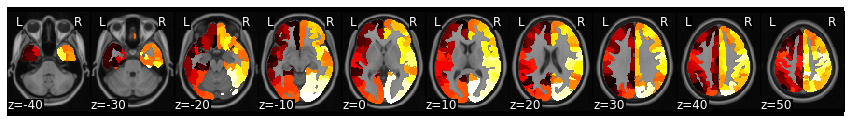

In [3]:
# Reading in cortical parcellations
mask = Brain_Data('/data/tools/schaefer_parcellations/MNI/Schaefer2018_400Parcels_Kong2022_17Networks_order_FSLMNI152_1mm.nii.gz')

# Splitting the one collection of parcellations into separate binary masks for each region
mask_x = expand_mask(mask)

# Viewing the mask
mask.plot()

In [4]:
# Defining a new function to get a participants's data from this specific ROI
def get_subject_roi(data, roi):
    
    # Creating an empty data dictionary
    sub_rois = {}
    
    # Iterating through each of the subjects
    for sub in data:
        
        # Copying the data within the index which corresponds with the specific ROI identified and saving it in the new dictionary
        sub_rois[sub] = data[sub].iloc[:, roi]
        
    # Returning a dataframe of that ROI's data for each participant
    return pd.DataFrame(sub_rois)

In [5]:
# Defining a new function to track progress in for loops
def tracker(iteration,
            total,
            milestone = 50):
    
    # Check if this iteration hit a milestone
    if (iteration) % milestone == 0:
        
            # Printing progress
            print(f' {(iteration/(total-1))} % Complete ! | {datetime.datetime.now()}')

In [6]:
# Creating a function to clean the data
def data_cleaner(filepath):
    
    # Calculating how many files each participant has in their raw directory
    if len(os.listdir(os.path.join('/data/Uncertainty/data/raw', sub, '3_task-1', 'DICOM'))) != 0:
        nFiles=len(os.listdir(os.path.join('/data/Uncertainty/data/raw', sub, '3_task-1', 'DICOM')))
    print

    # Reading in the data for this run
    data = pd.read_csv(filepath)

    # If this participant has 729 files
    if nFiles == 729:

        # Remove the first and last 30 observations (corresponding to the 60s buffer before and after)
        data = data.drop(data.index[range(30)])
        data = data.drop(data.tail(30).index)

    # If this participant has 759 files    
    if nFiles == 759:

        # Remove the first and last 30 observations (corresponding to the 90s buffer before and after)
        data = data.drop(data.index[range(45)])
        data = data.drop(data.tail(45).index)

    # If this participant doesn't jhave 729 or 759 files
    if nFiles != 729 and nFiles != 759:
        print(("Subject " + sub + " has " + str(nFiles) +" files in their raw directory, an abnormal quantity. Please check directory for errors."))

    # Reset the index 
    data = data.reset_index()
    data = data.drop(columns=['index'])

    # Adding participant data to the dictionary
    return data    

In [7]:
# Defining which subjects rated in the first half of the video
A_list = ['sub-0208', 'sub-0757', 'sub-2610', 'sub-2758', 'sub-3046', 
          'sub-3801', 'sub-3951', 'sub-4407', 'sub-4590', 'sub-6021', 
          'sub-6269', 'sub-6773', 'sub-6799', 'sub-7758', 'sub-8607', 
          'sub-8621', 'sub-8746', 'sub-9436', 'sub-9827', 'sub-9907']

# Defining which subjects rated in the first half of the video
B_list = ['sub-0295', 'sub-2579', 'sub-3011', 'sub-3274', 'sub-3952', 
          'sub-3981', 'sub-4781', 'sub-5006', 'sub-5849', 'sub-6215', 
          'sub-6971', 'sub-6977', 'sub-7255', 'sub-7492', 'sub-8929']

n_bootstraps_isc = 10000
n_bootstraps_isc_group = 10000

# First Half Video Raters

In [8]:
# NOTE: Participants saw a fixation and checkered pattern before and after each video. 
# Some were 60s and some were 90s (due to some early confusion). We want to remove that
# activation for everyone while paying special attention to which group they are in.

# Creating an empty dictionary to house subject data
sub_timeseries_A1 = {}

# Iterating through each of our subjects
for sub in A_list:

    # Cleaning the data
    sub_timeseries_A1[sub] = data_cleaner(os.path.join('/data/Uncertainty/scripts/3_Data/AvgROIs', 
                                                       f'{sub}_run-1_nROI-400_avgROI.csv'))

# Creating dictionaries to house the statistic and significance
isc_r_A1, isc_p_A1 = {}, {}

# Iterating through all 100 ROIs
for roi in range(400):
    
    # Calculating the ISC for this region
    stats = isc(get_subject_roi(sub_timeseries_A1, (roi)), 
                n_bootstraps= n_bootstraps_isc, 
                metric='median', 
                method='bootstrap')
    
    # Saving the statistic and signficance to the dictionary
    isc_r_A1[roi], isc_p_A1[roi] = stats['isc'], stats['p']
    
    # Tracking Progress
    tracker(iteration = roi, total = 400)

# Adjust p-values for multiple comparisons using the Benjamini-Hochberg procedure
p_values = np.array(list(isc_p_A1.values()))
isc_padj_A1 = multipletests(p_values, alpha=0.01, method='fdr_bh')[1]
isc_padj_A1 = dict(zip(isc_p_A1.keys(), isc_padj_A1))
    
# Projecting these values back to their corresponding mask regions 
isc_r_brain_A1, isc_padj_brain_A1 = roi_to_brain(pd.Series(isc_r_A1), mask_x), roi_to_brain(pd.Series(isc_padj_A1), mask_x)
                          

/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  warnings.warn(message, FutureWarning)
/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  warnings.warn(message, FutureWarning)
/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  

/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  warnings.warn(message, FutureWarning)
/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  warnings.warn(message, FutureWarning)
/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  

 0.0 % Complete ! | 2024-06-15 09:29:26.575842
 0.12531328320802004 % Complete ! | 2024-06-15 09:36:04.527306
 0.2506265664160401 % Complete ! | 2024-06-15 09:43:05.755310
 0.37593984962406013 % Complete ! | 2024-06-15 09:50:01.855118
 0.5012531328320802 % Complete ! | 2024-06-15 09:57:01.558281
 0.6265664160401002 % Complete ! | 2024-06-15 10:04:04.337747
 0.7518796992481203 % Complete ! | 2024-06-15 10:11:05.532733
 0.8771929824561403 % Complete ! | 2024-06-15 10:18:04.709656


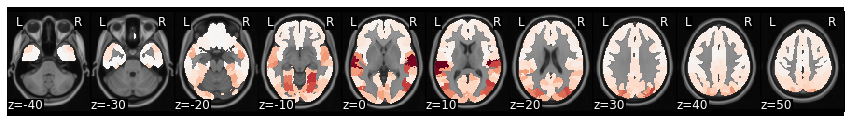

In [9]:
# Visualizing values with a slice plot
isc_r_brain_A1.plot(cmap='RdBu_r')

In [10]:
# 3D Image of the Brain Data
view_img_on_surf(threshold(isc_r_brain_A1, isc_padj_brain_A1, thr=.01).to_nifti())

# First Half Video Non-Raters

In [11]:
# NOTE: Participants saw a fixation and checkered pattern before and after each video. 
# Some were 60s and some were 90s (due to some early confusion). We want to remove that
# activation for everyone while paying special attention to which group they are in.

# Creating an empty dictionary to house subject data
sub_timeseries_B1 = {}

# Iterating through each of our subjects
for sub in B_list:

    # Cleaning the data
    sub_timeseries_B1[sub] = data_cleaner(os.path.join('/data/Uncertainty/scripts/3_Data/AvgROIs', 
                                          f'{sub}_run-1_nROI-400_avgROI.csv'))  

# Creating dictionaries to house the statistic and significance
isc_r_B1, isc_p_B1 = {}, {}

# Iterating through all 100 ROIs
for roi in range(400):
    
    # Calculating the ISC for this region
    stats = isc(get_subject_roi(sub_timeseries_B1, (roi)), 
                n_bootstraps= n_bootstraps_isc, 
                metric='median', 
                method='bootstrap')
    
    # Saving the statistic and signficance to the dictionary
    isc_r_B1[roi], isc_p_B1[roi] = stats['isc'], stats['p']
    
    # Tracking Progress
    tracker(iteration = roi, total = 400) 

# Adjust p-values for multiple comparisons using the Benjamini-Hochberg procedure
p_values = np.array(list(isc_p_B1.values()))
isc_padj_B1 = multipletests(p_values, alpha=0.01, method='fdr_bh')[1]
isc_padj_B1 = dict(zip(isc_p_B1.keys(), isc_padj_B1))    
    
# Projecting these values back to their corresponding mask regions 
isc_r_brain_B1, isc_padj_brain_B1 = roi_to_brain(pd.Series(isc_r_B1), mask_x), roi_to_brain(pd.Series(isc_padj_B1), mask_x)
 

 0.0 % Complete ! | 2024-06-15 10:25:11.647883
 0.12531328320802004 % Complete ! | 2024-06-15 10:31:43.548463
 0.2506265664160401 % Complete ! | 2024-06-15 10:38:36.930394
 0.37593984962406013 % Complete ! | 2024-06-15 10:45:37.566981
 0.5012531328320802 % Complete ! | 2024-06-15 10:52:33.937979
 0.6265664160401002 % Complete ! | 2024-06-15 10:59:34.239720
 0.7518796992481203 % Complete ! | 2024-06-15 11:06:34.469078
 0.8771929824561403 % Complete ! | 2024-06-15 11:13:28.802388


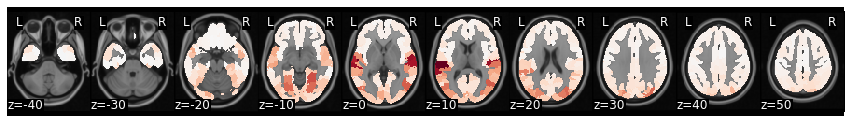

In [12]:
# Visualizing values with a slice plot
isc_r_brain_B1.plot(cmap='RdBu_r')

In [13]:
# 3D Image of the Brain Data
view_img_on_surf(threshold(isc_r_brain_B1, isc_padj_brain_B1, thr=.01).to_nifti())

# First Half Rater v. Non-Rater Comparison

In [14]:
# Creating dictionaries to house the statistic and significance
isc_rdiff_R1, isc_p_R1 = {}, {}

# Iterating through all 100 ROIs
for roi in range(400):
    
    # Calculating the ISC for this region
    compare = isc_group(get_subject_roi(sub_timeseries_A1, (roi)),
                        get_subject_roi(sub_timeseries_B1, (roi)),
                        n_samples= n_bootstraps_isc_group, 
                        metric='median', 
                        method='bootstrap')
    
    # Saving the statistic and signficance to the dictionary
    isc_rdiff_R1[roi], isc_p_R1[roi] = compare['isc_group_difference'], compare['p']
    
    # Tracking Progress
    tracker(iteration = roi, total = 400)

# Adjust p-values for multiple comparisons using the Benjamini-Hochberg procedure
p_values = np.array(list(isc_p_R1.values()))
isc_padj_R1 = multipletests(p_values, alpha=0.01, method='fdr_bh')[1]
isc_padj_R1 = dict(zip(isc_p_R1.keys(), isc_padj_R1))   
    
# Projecting these values back to their corresponding mask regions 
isc_rdiff_brain_R1, isc_padj_brain_R1 = roi_to_brain(pd.Series(isc_rdiff_R1), mask_x), roi_to_brain(pd.Series(isc_padj_R1), mask_x)

 0.0 % Complete ! | 2024-06-15 11:20:19.284472
 0.12531328320802004 % Complete ! | 2024-06-15 11:34:09.416916
 0.2506265664160401 % Complete ! | 2024-06-15 11:48:10.877730
 0.37593984962406013 % Complete ! | 2024-06-15 12:02:00.556469
 0.5012531328320802 % Complete ! | 2024-06-15 12:15:57.293140
 0.6265664160401002 % Complete ! | 2024-06-15 12:29:52.469194
 0.7518796992481203 % Complete ! | 2024-06-15 12:43:57.251090
 0.8771929824561403 % Complete ! | 2024-06-15 12:57:53.379480


In [15]:
# Reporting regions showing significant differences
df = pd.DataFrame({'R Difference': list(isc_rdiff_R1.values()), 
                   'P Value': list(isc_padj_R1.values())})

display(df[df['P Value'] < 0.01])

,R Difference,P Value
11,-0.017644,0.001143
38,0.024157,0.001143
39,0.028235,0.001143
64,0.042200,0.001143
70,0.013037,0.001143
73,-0.012316,0.001143
87,-0.066257,0.001143
96,0.040289,0.001143
122,0.005317,0.001143
138,-0.102046,0.001143


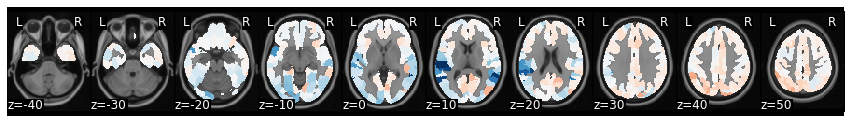

In [16]:
# Visualizing values with a slice plot
isc_rdiff_brain_R1.plot(cmap='RdBu_r')

In [17]:
# # 3D Image of the Brain Data
# index = [3,23,35,39,41,44,57,80,83,99]
# Rdiff = [-0.036,0.008, -0.137,-0.023,-0.044,-0.082,-0.050,-0.101,-0.019,-0.033]
# p=[0.001,0.001,0.001,0.001,0.001,0.001,0.001,0.001,0.001,0.001]

# # Create a DataFrame with 100 rows, initialized with zeros
# df = pd.DataFrame({'Rdiff': [0] * 100, 'p': [0] * 100})

# # Update the values based on the index array
# for i in range(len(index)):
#     df.loc[index[i], 'Rdiff'] = Rdiff[i]
#     df.loc[index[i], 'p'] = p[i]
        
# # Turning Rdiff back into an array
# isc_rdiff_R1 = df['Rdiff'].to_numpy()
# isc_padj_R1 = df['p'].to_numpy()

# # Projecting these values back to their corresponding mask regions 
# isc_rdiff_brain_R1, isc_padj_brain_R1 = roi_to_brain(pd.Series(isc_rdiff_R1), mask_x), roi_to_brain(pd.Series(isc_padj_R1), mask_x)

# view_img_on_surf(threshold(isc_rdiff_brain_R1, isc_padj_brain_R1, thr=.01).to_nifti(),cmap = "cold_white_hot", black_bg = True)

# Second Half Video Raters

In [18]:
# NOTE: Participants saw a fixation and checkered pattern before and after each video. 
# Some were 60s and some were 90s (due to some early confusion). We want to remove that
# activation for everyone while paying special attention to which group they are in.

# Creating an empty dictionary to house subject data
sub_timeseries_B2 = {}

# Iterating through each of our subjects
for sub in B_list:

    # Cleaning the data
    sub_timeseries_B2[sub] = data_cleaner(os.path.join('/data/Uncertainty/scripts/3_Data/AvgROIs', 
                                          f'{sub}_run-2_nROI-400_avgROI.csv'))

# Creating dictionaries to house the statistic and significance
isc_r_B2, isc_p_B2 = {}, {}

# Iterating through all 100 ROIs
for roi in range(400):
    
    # Calculating the ISC for this region
    stats = isc(get_subject_roi(sub_timeseries_B2, (roi)), 
                n_bootstraps=n_bootstraps_isc, 
                metric='median', 
                method='bootstrap')
    
    # Saving the statistic and signficance to the dictionary
    isc_r_B2[roi], isc_p_B2[roi] = stats['isc'], stats['p']
    
    # Tracking Progress
    tracker(iteration = roi, total = 400) 

# Adjust p-values for multiple comparisons using the Benjamini-Hochberg procedure
p_values = np.array(list(isc_p_B2.values()))
isc_padj_B2 = multipletests(p_values, alpha=0.01, method='fdr_bh')[1]
isc_padj_B2 = dict(zip(isc_p_B2.keys(), isc_padj_B2))    
    
# Projecting these values back to their corresponding mask regions 
isc_r_brain_B2, isc_padj_brain_B2 = roi_to_brain(pd.Series(isc_r_B2), mask_x), roi_to_brain(pd.Series(isc_padj_B2), mask_x)
                          

 0.0 % Complete ! | 2024-06-15 13:11:33.962490
 0.12531328320802004 % Complete ! | 2024-06-15 13:18:38.610891
 0.2506265664160401 % Complete ! | 2024-06-15 13:25:26.696421
 0.37593984962406013 % Complete ! | 2024-06-15 13:32:25.410803
 0.5012531328320802 % Complete ! | 2024-06-15 13:39:15.735952
 0.6265664160401002 % Complete ! | 2024-06-15 13:46:22.811147
 0.7518796992481203 % Complete ! | 2024-06-15 13:53:24.541502
 0.8771929824561403 % Complete ! | 2024-06-15 14:00:27.485407


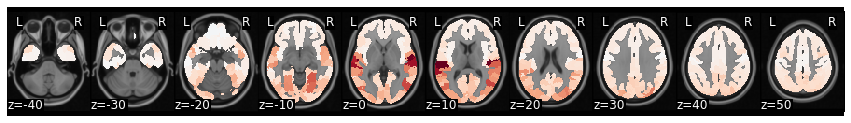

In [19]:
# Visualizing values with a slice plot
isc_r_brain_B2.plot(cmap='RdBu_r')

In [20]:
# 3D Image of the Brain Data
view_img_on_surf(threshold(isc_r_brain_B2, isc_padj_brain_B2, thr=.01).to_nifti())

# Second Half Video Non-Raters

In [21]:
# NOTE: Participants saw a fixation and checkered pattern before and after each video. 
# Some were 60s and some were 90s (due to some early confusion). We want to remove that
# activation for everyone while paying special attention to which group they are in.

# Creating an empty dictionary to house subject data
sub_timeseries_A2 = {}

# Iterating through each of our subjects
for sub in A_list:

    # Cleaning the data
    sub_timeseries_A2[sub] = data_cleaner(os.path.join('/data/Uncertainty/scripts/3_Data/AvgROIs', 
                                          f'{sub}_run-2_nROI-400_avgROI.csv'))

# Creating dictionaries to house the statistic and significance
isc_r_A2, isc_p_A2 = {}, {}

# Iterating through all 100 ROIs
for roi in range(400):
    
    # Calculating the ISC for this region
    stats = isc(get_subject_roi(sub_timeseries_A2, (roi)), 
                n_bootstraps=n_bootstraps_isc, 
                metric='median', 
                method='bootstrap')
    
    # Saving the statistic and signficance to the dictionary
    isc_r_A2[roi], isc_p_A2[roi] = stats['isc'], stats['p']
    
    # Tracking Progress
    tracker(iteration = roi, total = 400)

# Adjust p-values for multiple comparisons using the Benjamini-Hochberg procedure
p_values = np.array(list(isc_p_A2.values()))
isc_padj_A2 = multipletests(p_values, alpha=0.01, method='fdr_bh')[1]
isc_padj_A2 = dict(zip(isc_p_A2.keys(), isc_padj_A2))    
    
# Projecting these values back to their corresponding mask regions 
isc_r_brain_A2, isc_padj_brain_A2 = roi_to_brain(pd.Series(isc_r_A2), mask_x), roi_to_brain(pd.Series(isc_padj_A2), mask_x)
                  

 0.0 % Complete ! | 2024-06-15 14:07:30.236362
 0.12531328320802004 % Complete ! | 2024-06-15 14:14:32.839075
 0.2506265664160401 % Complete ! | 2024-06-15 14:21:34.498600
 0.37593984962406013 % Complete ! | 2024-06-15 14:28:35.869502
 0.5012531328320802 % Complete ! | 2024-06-15 14:35:44.153932
 0.6265664160401002 % Complete ! | 2024-06-15 14:42:34.475239
 0.7518796992481203 % Complete ! | 2024-06-15 14:49:36.882643
 0.8771929824561403 % Complete ! | 2024-06-15 14:56:45.814888


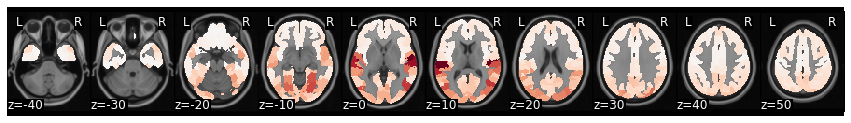

In [22]:
# Visualizing values with a slice plot
isc_r_brain_A2.plot(cmap='RdBu_r')

In [23]:
# 3D Image of the Brain Data
view_img_on_surf(threshold(isc_r_brain_A2, isc_padj_brain_A2, thr=.01).to_nifti())

# Second Half Rater v. Non-Rater Comparison

In [32]:
# Creating dictionaries to house the statistic and significance
isc_rdiff_R2, isc_p_R2 = {}, {}

# Iterating through all 100 ROIs
for roi in range(400):
    
    # Calculating the ISC for this region
    compare = isc_group(get_subject_roi(sub_timeseries_B2, (roi)),
                        get_subject_roi(sub_timeseries_A2, (roi)),
                        n_samples=n_bootstraps_isc_group, 
                        metric='median', 
                        method='bootstrap')
    
    # Saving the statistic and signficance to the dictionary
    isc_rdiff_R2[roi], isc_p_R2[roi] = compare['isc_group_difference'], compare['p']
    
    # Tracking Progress
    tracker(iteration = roi, total = 400)

# Adjust p-values for multiple comparisons using the Benjamini-Hochberg procedure
p_values = np.array(list(isc_p_R2.values()))
isc_padj_R2 = multipletests(p_values, alpha=0.01, method='fdr_bh')[1]
isc_padj_R2 = dict(zip(isc_p_R2.keys(), isc_padj_R2))    
            
# Projecting these values back to their corresponding mask regions 
isc_rdiff_brain_R2, isc_padj_brain_R2 = roi_to_brain(pd.Series(isc_rdiff_R2), mask_x), roi_to_brain(pd.Series(isc_padj_R2), mask_x)

/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  warnings.warn(message, FutureWarning)
/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  warnings.warn(message, FutureWarning)
/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  

/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  warnings.warn(message, FutureWarning)
/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  warnings.warn(message, FutureWarning)
/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  

 0.0 % Complete ! | 2024-06-15 22:04:58.307431
 0.12531328320802004 % Complete ! | 2024-06-15 22:18:27.954421
 0.2506265664160401 % Complete ! | 2024-06-15 22:32:33.703453
 0.37593984962406013 % Complete ! | 2024-06-15 22:46:33.560785
 0.5012531328320802 % Complete ! | 2024-06-15 23:00:32.420615
 0.6265664160401002 % Complete ! | 2024-06-15 23:14:32.275347
 0.7518796992481203 % Complete ! | 2024-06-15 23:28:27.839258
 0.8771929824561403 % Complete ! | 2024-06-15 23:42:34.079712


In [33]:
# Reporting regions showing significant differences
df = pd.DataFrame({'R Difference': list(isc_rdiff_R2.values()), 
                   'P Value': list(isc_padj_R2.values())})

display(df[df['P Value'] < 0.01])

,R Difference,P Value
2,-0.034270,0.000714
12,0.016653,0.000714
21,0.007906,0.000714
22,-0.037514,0.000714
23,-0.004171,0.000714
36,0.019392,0.000714
41,0.023831,0.000714
45,0.016081,0.000714
49,0.066038,0.000714
51,0.018572,0.000714


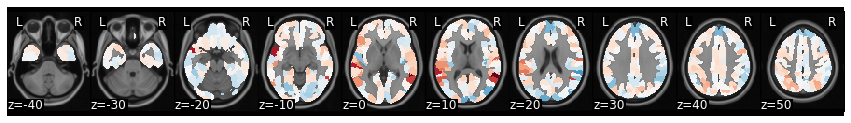

In [34]:
# Visualizing values with a slice plot
isc_rdiff_brain_R2.plot(cmap='RdBu_r')

In [35]:
# 3D Image of the Brain Data
view_img_on_surf(threshold(isc_rdiff_brain_R2, isc_padj_brain_R2, thr=.01).to_nifti())

# Combined Results

In [36]:
# Create a new dictionary to store the mean values
isc_rdiff = {}

# Iterate over the keys and calculate the mean for each key
for key in isc_rdiff_R2:
    isc_rdiff[key] = (isc_rdiff_R2[key] + isc_rdiff_R1[key]) / 2
    
# Create a new dictionary to store the combined p-values
isc_p = {}

# Iterate over the keys and apply Fisher's method
for key in isc_padj_R1:
    
    # Calculate the test statistic
    test_stat = -2 * (np.log(isc_p_R1[key]) + np.log(isc_p_R2[key]))
    
    # Calculate the combined p-value using the chi-square distribution
    combined_p = chi2.sf(test_stat, df=4)  # df = 2k, where k = 2 in this case
    
    # Store the combined p-value in the new dictionary
    isc_p[key] = combined_p
    
# Adjust p-values for multiple comparisons using the Benjamini-Hochberg procedure
p_values = np.array(list(isc_p.values()))
isc_padj = multipletests(p_values, alpha=0.01, method='fdr_bh')[1]
isc_padj = dict(zip(isc_p.keys(), isc_padj))    

# Projecting these values back to their corresponding mask regions 
isc_rdiff_brain, isc_padj_brain = roi_to_brain(pd.Series(isc_rdiff), mask_x), roi_to_brain(pd.Series(isc_padj), mask_x)

In [40]:
# Reporting regions showing significant differences
df = pd.DataFrame({'R Difference': list(isc_rdiff.values()), 
                   'P Value': list(isc_padj.values())})

display(df[df['P Value'] < 0.001])

,R Difference,P Value
141,-0.040806,0.000019
301,0.001330,0.000019
310,-0.013511,0.000019
336,-0.011436,0.000019


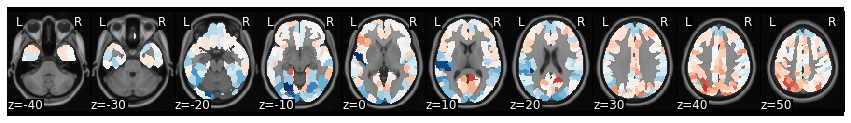

In [38]:
# Visualizing values with a slice plot
isc_rdiff_brain.plot(cmap='RdBu_r')

In [41]:
# 3D Image of the Brain Data
view_img_on_surf(threshold(isc_rdiff_brain, isc_padj_brain, thr=.01).to_nifti())